In [1]:
import numpy as np
import pandas as pd

import cv2
import json
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams["font.size"] = 15
import seaborn as sns
from collections import Counter
from PIL import Image
import math
import seaborn as sns
from collections import defaultdict
from pathlib import Path
import cv2
from tqdm import tqdm

In [2]:
import os
print(os.listdir("input/severstal-steel-defect-detection"))

['sample_submission.csv', 'test_images', 'train.csv', 'train_images']


In [3]:
df = pd.read_csv("input/severstal-steel-defect-detection/train.csv")
df['ImageId'], df['ClassId'] = zip(*df['ImageId_ClassId'].str.split('_'))
df['ClassId'] = df['ClassId'].astype(int)
df = df.pivot(index='ImageId', columns='ClassId', values='EncodedPixels')
df['defects'] = df.count(axis=1)
print('总图片数')
print(len(df))
df_defect = df[df['defects']>0]
print('含有缺陷的图片数')
print(len(df_defect))

总图片数
12568
含有缺陷的图片数
6666


In [4]:
def get_label(row_id, df):
    num_defects = df.iloc[row_id]['defects']
    return int(num_defects>0)

In [4]:
#含有x个类的图片数
defects_num = [0]*5
for row in range(len(df)):
    defects_num[df.iloc[row]['defects']]+=1
print('含有x个类的图片数:',defects_num)
#defects_num[0]代表正常图片

含有x个类的图片数: [1151, 594, 55, 1, 0]


In [5]:
#含有类c的图片数
num_img = len(df)
class_num = [0]*4

for i in range(4):
    class_num[i] = np.sum(df.iloc[:,i].notnull())
print('含有类c的图片数:',class_num)

含有类c的图片数: [156, 76, 367, 108]


In [17]:
a = np.array([5902,897, 247, 5150, 801])
a.sum()/a
#[2.2,14,52,2.5,16]

array([ 2.20213487, 14.48940914, 52.6194332 ,  2.52368932, 16.22596754])

In [6]:
a = np.sum(class_num)/np.array(class_num)
a/a.sum()

array([0.16875917, 0.61286225, 0.02939359, 0.18898499])

In [4]:
def make_mask(row_id, df):
    '''Given a row index, return image_id and mask (256, 1600, 4)'''
    fname = df.iloc[row_id].name
    labels = df.iloc[row_id][:4]
    masks = np.zeros((256, 1600, 4), dtype=np.uint8) # float32 is V.Imp
    # 4:class 1～4 (ch:0～3)

    for idx, label in enumerate(labels.values):
        if label is not np.nan:
            label = label.split(" ")
            positions = map(int, label[0::2])
            length = map(int, label[1::2])
            mask = np.zeros(256 * 1600, dtype=np.uint8)
            for pos, le in zip(positions, length):
                mask[pos:(pos + le)] = 1
            masks[:, :, idx] = mask.reshape(256, 1600, order='F')
    return fname, masks

In [8]:
def calculate_pixel(mask):
    #mask:[256, 1600, 4] np.array
    count_res = [0]*5
    num_classes = mask.shape[-1]
    for c in range(num_classes): #4
        mask_layer = mask[:,:,c]
        count_res[c+1] = np.sum(mask_layer).item()
    count_res[0] = np.sum(np.sum(mask,axis=-1)==0).item()
    return np.array(count_res).astype('float64')

In [28]:
count = np.array([0,0,0,0,0]).astype('float64')
for i in range(len(df_defect)):
    img_name,mask = make_mask(i,df_defect)
    count_ele = calculate_pixel(mask)
    count=count_ele + count
    if i%100==0:
        print(i//100,end='')
print('各个类所占据的像素数量统计：')
count

0123456789101112131415161718192021222324252627282930313233343536373839404142434445464748495051525354555657585960616263646566各个类所占据的像素数量统计：


array([2.56680654e+09, 3.91212900e+06, 8.34471000e+05, 1.31306893e+08,
       2.75335700e+07])

In [29]:
#得到权重比例：
count_save = [1,1000,1000,10,100]

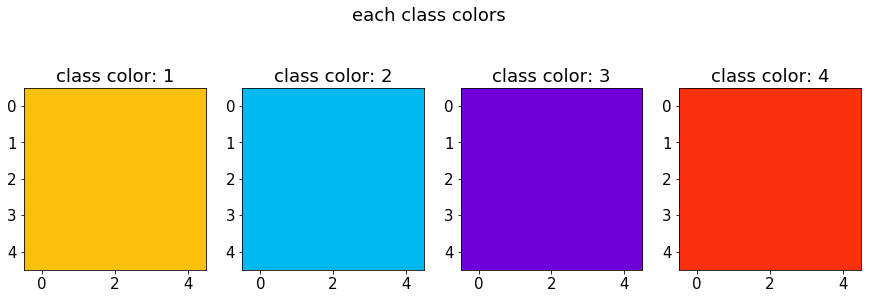

In [5]:
palet = [(249, 192, 12), (0, 185, 241), (114, 0, 218), (249,50,12)]

fig, ax = plt.subplots(1, 4, figsize=(15, 5))
for i in range(4):
    #ax[i].axis('off')
    ax[i].imshow(np.ones((5, 5, 3)).astype(np.uint8) * palet[i])
    ax[i].set_title("class color: {}".format(i+1))
fig.suptitle("each class colors")

plt.show()

In [23]:
def find_roi(image,mask):
    # masks:[256, 1600, 4]
    defect_detection = mask.sum(0).sum(1)
    while(1):
        #寻找合适的滑动窗口，滑动窗口为256x256
        center = np.random.randint(low=130,high=1472)
        left,right = center-127, center+128
        pixels = np.sum(defect_detection[left:right+1])
        if pixels>=200: #中心已找到
            break
    return image[:,left:right+1,:], mask[:,left:right+1,:]

In [ ]:
#验证提取roi效果
'''for i in range(200):
    img_name,mask = make_mask(i,df_defect)
    img = cv2.imread("input/severstal-steel-defect-detection/train_images/"+img_name)
    img_new = img.copy()
    
    defect_cnt = 0
    for ch in range(4): #<<<<<<<<<<<<定义类的种类
        contours, _ = cv2.findContours(mask[:,:,ch].astype(np.uint8), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

        for j in range(len(contours)):
            cv2.polylines(img_new, contours[j], True, palet[ch], 2)
            defect_cnt+=1
    if(defect_cnt>0):
        img_roi,mask_roi = find_roi(img,mask)'''

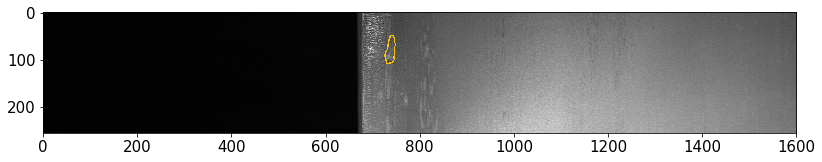

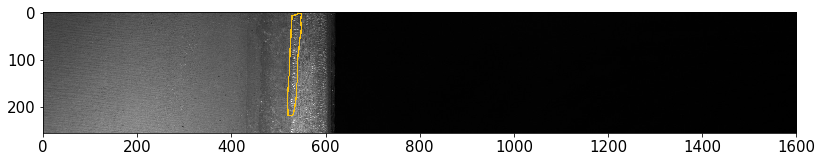

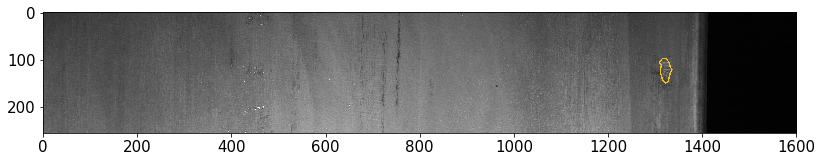

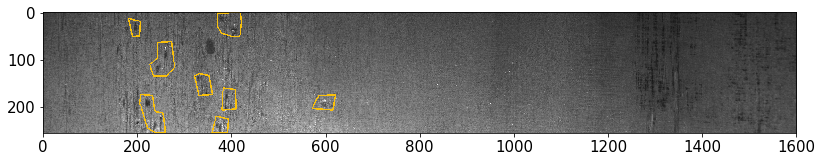

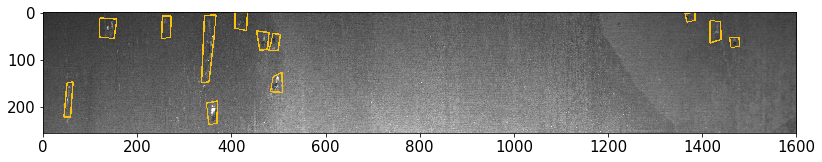

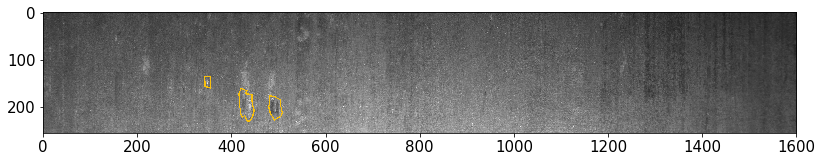

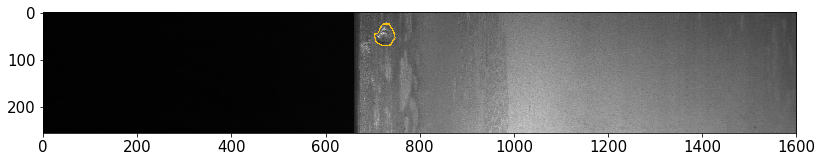

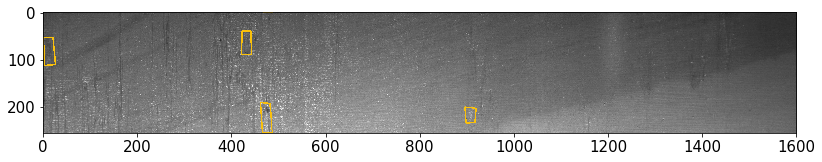

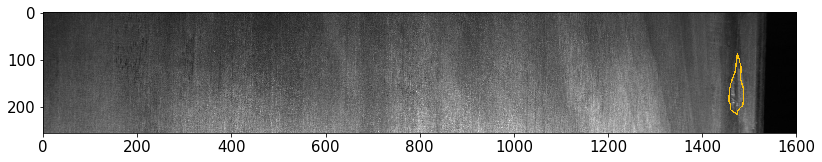

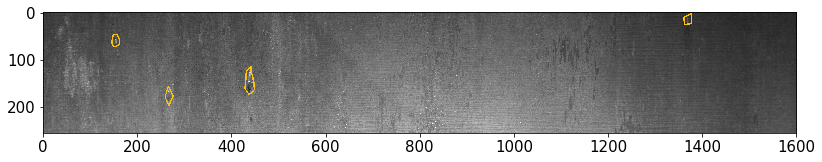

KeyboardInterrupt: 

In [6]:
#进行可视化，mask提取轮廓

for i in range(700,800):
    img_name,mask = make_mask(i,df)
    img_ori = cv2.imread("input/severstal-steel-defect-detection/train_images/"+img_name)
    img_new = img_ori.copy()
    
    defect_cnt = 0
    for ch in [0]: #<<<<<<<<<<<<定义类的种类
        contours, _ = cv2.findContours(mask[:,:,ch].astype(np.uint8), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

        for j in range(len(contours)):
            cv2.polylines(img_new, contours[j], True, palet[ch], 2)
            defect_cnt+=1
    if(defect_cnt>0):
        '''fig, ax = plt.subplots(1, 2, figsize=(15, 5))
        ax[0].imshow(img_ori)
        ax[0].set_title(str(i))
        ax[1].imshow(img_new)
        ax[1].set_title(str(i))
        plt.show()'''
        plt.figure(figsize=(13.5,2.5))
        plt.imshow(img_new)
        plt.show()
    

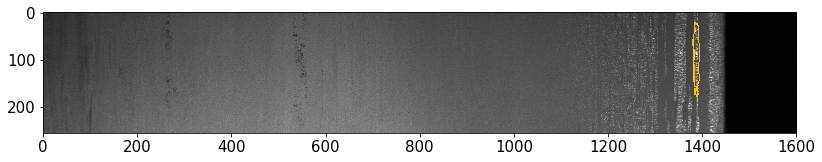

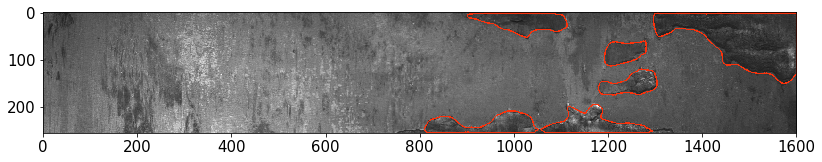

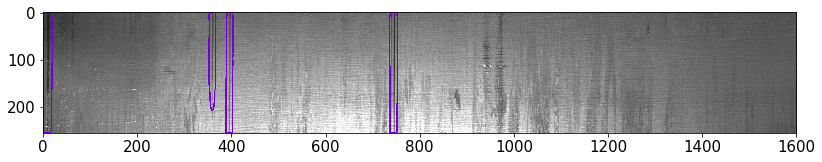

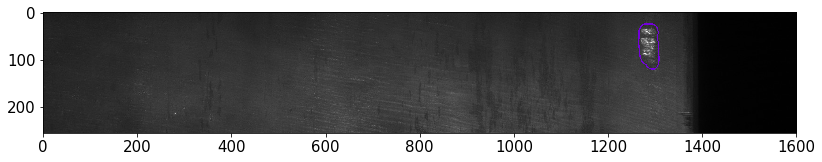

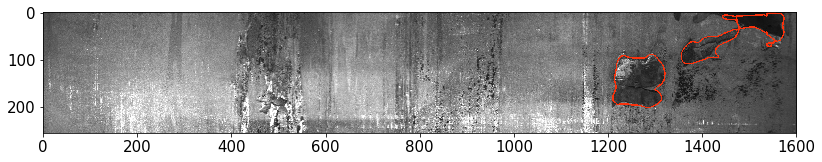

...

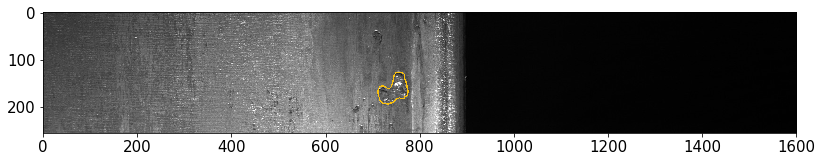

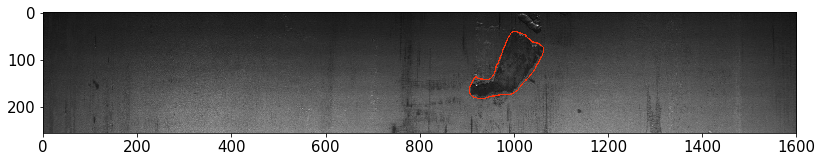

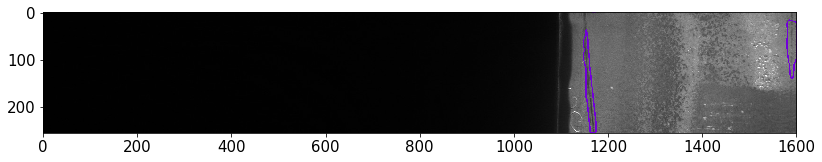

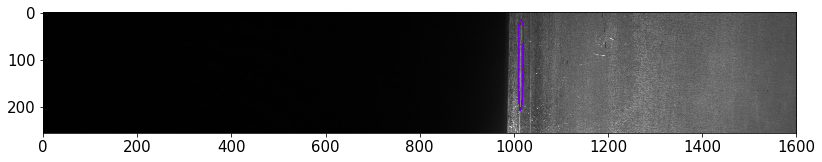

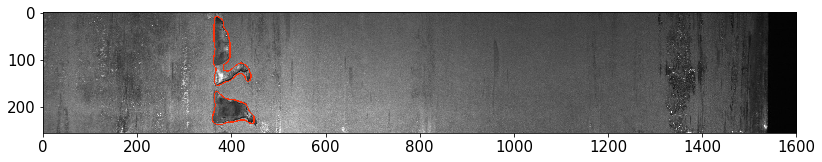

0


In [8]:
#inference结果可视化，mask提取轮廓
df_inf = pd.read_csv("submission.csv")

df_inf['ImageId'], df_inf['ClassId'] = zip(*df_inf['ImageId_ClassId'].str.split('_'))
df_inf['ClassId'] = df_inf['ClassId'].astype(int)
df_inf = df_inf.pivot(index='ImageId', columns='ClassId', values='EncodedPixels')
df_inf['defects'] = df_inf.count(axis=1)
total_neg=0
for i in range(800,1000):
    img_name,mask = make_mask(i,df_inf)
    img_ori = cv2.imread("input/severstal-steel-defect-detection/test_images/"+img_name)
    img_new = img_ori.copy()
    
    total_def_pic = 0
    defect_cnt = 0
    for ch in range(4): #<<<<<<<<<<<<定义类的种类
        contours, _ = cv2.findContours(mask[:,:,ch].astype(np.uint8), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

        for j in range(len(contours)):
            cv2.polylines(img_new, contours[j], True, palet[ch], 2)
            defect_cnt+=1
    if(defect_cnt>0):
        total_def_pic+=1
        '''fig, ax = plt.subplots(1, 2, figsize=(15, 5))
        ax[0].imshow(img_ori)
        ax[0].set_title(str(i))
        ax[1].imshow(img_new)
        ax[1].set_title(str(i))
        plt.show()'''
        plt.figure(figsize=(13.5,2.5))
        plt.imshow(img_new)
        plt.show()
print(total_def_pic)

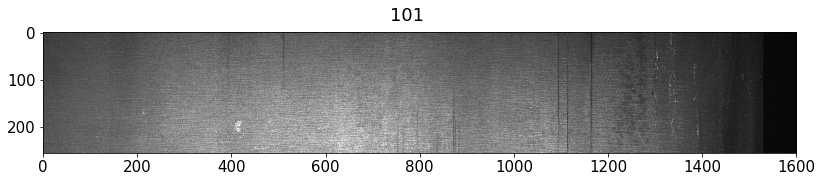

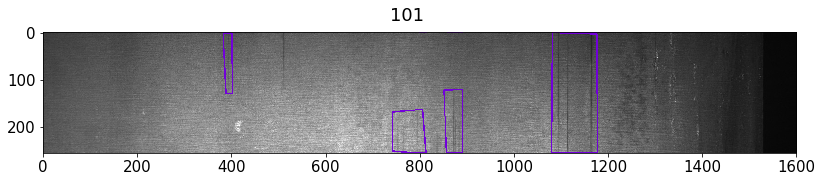

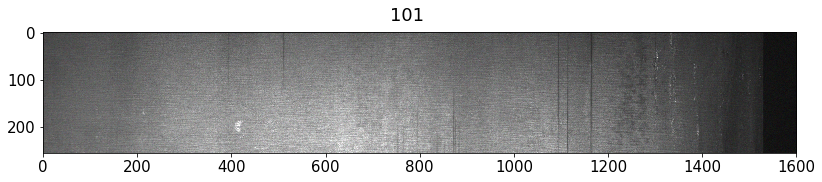

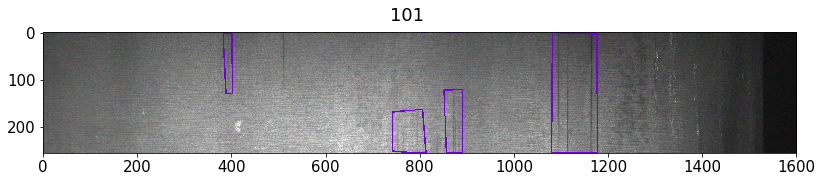

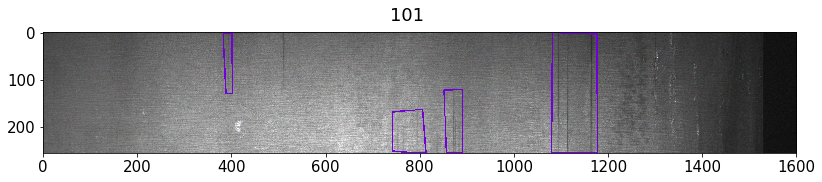

...

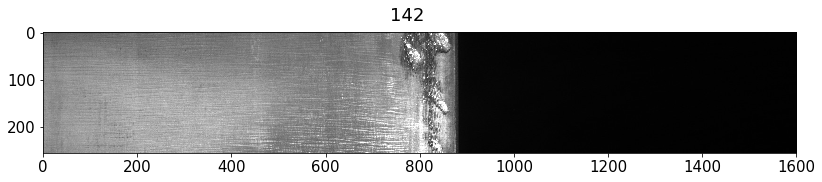

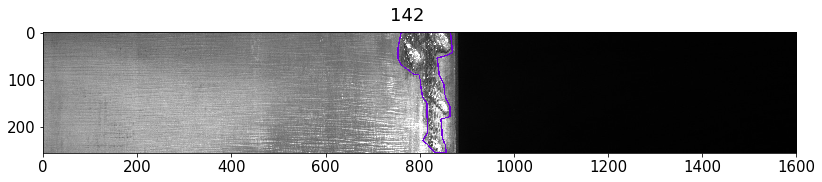

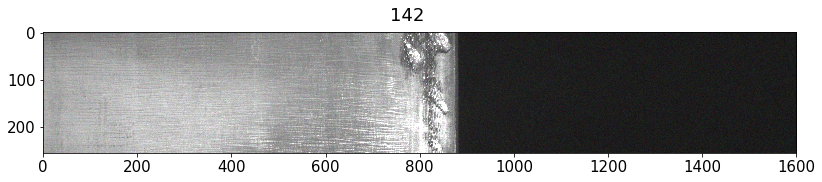

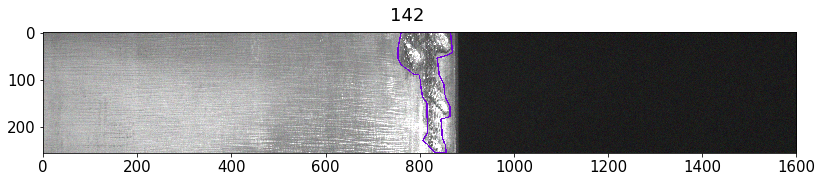

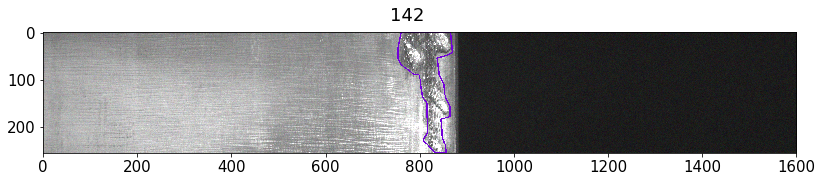

KeyboardInterrupt: 

In [7]:
#图像增强可视化
from albumentations import *
import random

#list_trfms = Compose([ShiftScaleRotate(p=1,shift_limit=0.7, scale_limit=0, rotate_limit=0, border_mode = cv2.BORDER_CONSTANT)])
list_trfms = Compose([GaussNoise(p=1)]) #,var_limit=20.




for i in range(100,150):
    img_name,mask = make_mask(i,df)  # mask :(256, 1600, 4)
    img_ori = cv2.imread("input/severstal-steel-defect-detection/train_images/"+img_name)
    img_new = img_ori.copy()
    

    res = list_trfms(image = img_ori, mask = mask)
    img_tran_ori = res['image']
    mask_tran = res['mask']

    img_tran = img_tran_ori.copy()
    img_tran_quiet = img_tran_ori.copy()
    
    
    #增强后的mask去噪
    mask_tran_quiet = mask_tran.copy()
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(3,3))
    for ch in range(4):
        mask_tran_quiet[:,:,ch] = cv2.morphologyEx(mask_tran_quiet[:,:,ch], cv2.MORPH_OPEN, kernel)
    
    defect_cnt = 0
    for ch in range(4): #<<<<<<<<<<<<<<<<<<<定义类的种类
        contours, _ = cv2.findContours(mask[:,:,ch].astype(np.uint8), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
        contours2, _ = cv2.findContours(mask_tran[:,:,ch].astype(np.uint8), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
        contours3, _ = cv2.findContours(mask_tran_quiet[:,:,ch].astype(np.uint8), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
        
        for j in range(len(contours)):
            cv2.polylines(img_new, contours[j], True, palet[ch], 2)
            defect_cnt+=1

        for k in range(len(contours2)):
            cv2.polylines(img_tran, contours2[k], True, palet[ch], 2)
            
        for k in range(len(contours3)):
            cv2.polylines(img_tran_quiet, contours3[k], True, palet[ch], 2)
            
    if(defect_cnt>0):
        plt.figure(figsize=(13.5,2.5))
        plt.suptitle(str(i))
        plt.imshow(img_ori)
        plt.show()
        
        plt.figure(figsize=(13.5,2.5))
        plt.suptitle(str(i))
        plt.imshow(img_new)
        plt.show()
        
        plt.figure(figsize=(13.5,2.5))
        plt.suptitle(str(i))
        plt.imshow(img_tran_ori)
        plt.show()
        
        plt.figure(figsize=(13.5,2.5))
        plt.suptitle(str(i))
        plt.imshow(img_tran)
        plt.show()
        
        plt.figure(figsize=(13.5,2.5))
        plt.suptitle(str(i))
        plt.imshow(img_tran_quiet)
        plt.show()